In [2]:
import os
import argparse
import numpy as np
import matplotlib.pyplot as plt
import torch

import json
import yaml
import cv2
from glob import glob
from tqdm import tqdm

if 'google.colab' in str(get_ipython()):

    !pip install apriltag

    !git clone https://github.com/marcbadger/aviary.git
    os.chdir('aviary')
    !git checkout calibration_fix
    os.chdir('calibration')

    # To find local version of the library
    sys.path.append(os.path.join('aviary', 'calibration'))

import apriltag
# an alterative detector from a different package is pupil_apriltags

import utils.img_utils as img_utils
import utils.multiview_utils as mutils
from utils.geometry import perspective_projection, rot6d_to_rotmat
from optimization.losses import gmof

# Annotating matching 3D points for calibration

In [3]:
# note this assumes you are running this notebook from inside
# the aviary folder
root = os.getcwd()

In [4]:
# These are some random points in the aviary that I could see from cameras on both ends of the aviary
# It's a numpy array that has shape 8 x 11 x 3.
# The first dimension is the view number from the filename view0...view7.
# The second dimension is the point index (I clicked 11 points in the aviary).  The third dimension is the location
# and a visibility score: [x, y, visible]. x is measured in pixels from the left edge of the image and y is
# measured in the downward direction from the top edge. visible is either 0 (not visible) or 1 (visible).

# I clicked these and exported a csv using https://www.makesense.ai/

aviary_points = np.array([
[[0,0,0], # first camera, first point - not visible
    [0,0,0], # second point - not visible
    [1192,166,1], # third point - visible at [1192, 116]
    [524,94,1],
    [0,0,0],
    [0,0,0],
    [1222,939,1],
    [438,905,1],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [1721,704,1],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [309,143,1],
    [277,189,1],
    [142,133,1],
    [0,0,0]],
[[0,0,0], # second camera
    [0,0,0],
    [1431,140,1],
    [758,193,1],
    [0,0,0],
    [0,0,0],
    [1499,969,1],
    [703,957,1],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [1609,674,1],
    [1643,50,1],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [0,0,0]],
[[0,0,0],
    [0,0,0],
    [1327,202,1],
    [619,227,1],
    [0,0,0],
    [0,0,0],
    [1370,1023,1],
    [631,991,1],
    [243,377,1],
    [899,365,1],
    [920,333,1],
    [1513,325,1],
    [696,424,1],
    [0,0,0],
    [1520,1180,1],
    [99,331,1],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [783,336,1]],
[[0,0,0],
    [0,0,0],
    [1256,200,1],
    [542,223,1],
    [0,0,0],
    [0,0,0],
    [1293,971,1],
    [559,1038,1],
    [0,0,0],
    [1613,348,1],
    [1269,324,1],
    [0,0,0],
    [1616,401,1],
    [1754,1105,1],
    [0,0,0],
    [372,329,1],
    [318,434,1],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [1145,324,1]],
[[1236,150,1],
    [498,121,1],
    [0,0,0],
    [0,0,0],
    [1283,916,1],
    [501,940,1],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [279,490,1],
    [343,239,1],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [1541,697,1],
    [0,0,0]],
[[1619,162,1],
    [876,233,1],
    [0,0,0],
    [0,0,0],
    [1662,1001,1],
    [865,1000,1],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [283,402,1],
    [0,0,0],
    [0,0,0],
    [1775,299,1],
    [1756,558,1],
    [0,0,0],
    [0,0,0]],
[[1398,200,1],
    [609,213,1],
    [0,0,0],
    [0,0,0],
    [1387,1021,1],
    [647,982,1],
    [0,0,0],
    [0,0,0],
    [979,345,1],
    [345,350,1],
    [85,435,1],
    [0,0,0],
    [0,0,0],
    [0,0,0],
    [53,879,1],
    [1653,390,1],
    [1575,384,1],
    [1540,1081,1],
    [1500,1083,1],
    [0,0,0],
    [303,432,1]],
[[1098,269,1],
    [308,283,1],
    [0,0,0],
    [0,0,0],
    [1100,1035,1],
    [359,1111,1],
    [0,0,0],
    [0,0,0],
    [1350,407,1],
    [0,0,0],
    [1083,508,1],
    [103,431,1],
    [798,430,1],
    [0,0,0],
    [182,1062,1],
    [0,0,0],
    [1774,429,1],
    [1726,1007,1],
    [1539,1035,1],
    [1352,1013,1],
    [0,0,0]]
])

In [5]:
# We can save this array as a .npy file so we can load it directly

np.save(os.path.join(root,'utils','aviary_points_v2.npy'), aviary_points)

# Optimizing 3D point locations to best fit 2D annotations

In [6]:
aviary_points = np.load(os.path.join(root, "utils","aviary_points_v2.npy"))
print(aviary_points.shape)

(8, 21, 3)


In [15]:
# These are the images on which points above were clicked:

calib_img_filenames = glob(os.path.join(root,"examples_multiview","view*_00017.png"))
calib_img_filenames.sort()

# And we can load the images with imread (and convert the color from BGR used by opencv to RGB)
# The [f(x) for x in y] is called a "list comprehension" and returns a new list the same length as y
# but with f(x) for each element x in y.

calib_images = [cv2.cvtColor(cv2.imread(file),cv2.COLOR_BGR2RGB) for file in calib_img_filenames]

In [16]:
# We can use a function inside the file utils/img_utils.py called draw_kpts to draw the points on the image
# This is useful to check that the points are where we intended and didn't get messed up along the way
# zip takes in two lists produces pairs of elements from each of its inputs

imgs_with_points = [img_utils.draw_kpts(ci, ap, r=4) for ci, ap in zip(calib_images, aviary_points)]

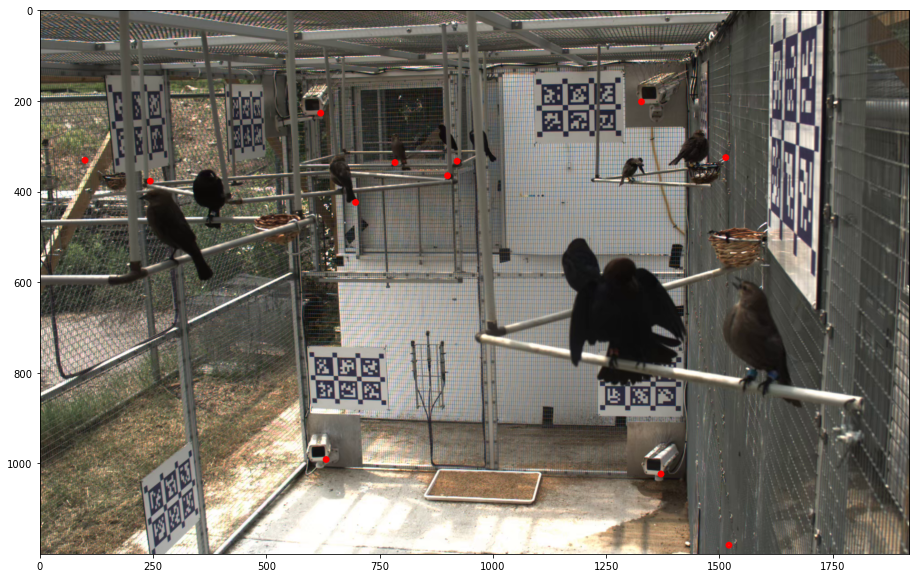

In [17]:
# plt is matplotlib.pyplot and can be used for displaying images (and also plotting)

# set the figure size to make it big
plt.figure(figsize=(20,10))

# plot the third image that is annotated with points
plt.imshow(imgs_with_points[2])
plt.show()

In [18]:
# The filenames have view number, which is the "camera number"
# We had a mixup early on with calibration and ended up calling
# cameras "frames" in a different order, but we can solve this
# with a dictionary that converts camera numbers to frame numbers
# camera 3 corresponds to frame 0 and so on.

cam_to_frame_map = {3:0,2:1,7:2,6:3,0:4,1:5,4:6,5:7}

# We will set where the computation will be done (cuda = GPU (fast), cpu = CPU (slow))
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# allocate a pytorch array for the 3d locations of the 11 points
# rows of the array will be [x, y, z, visible]
aviary_points_3d = torch.zeros([aviary_points.shape[1],4]).float()

# Now for each point, we optimize a 3D location so that it best agrees
# with the 2D reprojection back onto each camera from which it is visible

for ptnum in range(aviary_points.shape[1]):
    
    # cams will hold the view numbers from which the point is visible
    cams = []
    
    # the rows of pts will be the [x, y, visibility] corresponding
    # to each camera that sees it
    pts = []
    
    # For each camera, we check if the current point (ptnum) is visible
    for cam, campts in enumerate(aviary_points[:,ptnum,:]):
        if not campts[-1] == 0:
            cams.append(cam)
            pts.append(campts)
    
    # Now we convert those view/cam numbers into "frame" numbers
    frames = [cam_to_frame_map[cam] for cam in cams]
    
    # Convert the pts list into a pytorch array with the correct shape
    # which is num_cams x 1 x 2
    pts = torch.from_numpy(np.array(pts)[:,np.newaxis,:2]).to(device)

    # Triangulation with LBFGS
    # the function get_gt_3d is inside utils/multiview_utils.py
    aviary_points_3d[ptnum,:] = mutils.get_gt_3d(pts, frames, LBFGS=True).detach()

In [19]:
aviary_points_3d

tensor([[ 0.4159,  2.2059,  2.2236,  1.0000],
        [ 0.3780,  0.2499,  2.2362,  1.0000],
        [ 5.6309,  0.2242,  2.2620,  1.0000],
        [ 5.6686,  2.0053,  2.2213,  1.0000],
        [ 0.4417,  2.2007,  0.1801,  1.0000],
        [ 0.3905,  0.2436,  0.1928,  1.0000],
        [ 5.6006,  0.0827,  0.2011,  1.0000],
        [ 5.6264,  2.0528,  0.1845,  1.0000],
        [ 2.9316,  1.6040,  2.0730,  1.0000],
        [ 2.9224,  0.7247,  2.0825,  1.0000],
        [ 3.8102,  0.8708,  2.0668,  1.0000],
        [ 3.1149, -0.0199,  2.1208,  1.0000],
        [ 2.6177,  0.8907,  2.0436,  1.0000],
        [ 3.5809, -0.0307,  0.6419,  1.0000],
        [ 2.6265, -0.0231,  1.1987,  1.0000],
        [ 3.7561,  2.3279,  2.0887,  1.0000],
        [ 2.9144,  2.3536,  2.0174,  1.0000],
        [ 2.8918,  2.3397,  1.0769,  1.0000],
        [ 2.3608,  2.3305,  0.8453,  1.0000],
        [ 1.5821,  2.3504,  0.6214,  1.0000],
        [ 3.7937,  1.0942,  2.0652,  1.0000]])

In [20]:
print(aviary_points_3d.shape)
print(aviary_points_3d.device)

torch.Size([21, 4])
cpu


In [21]:
# Now we check visually to see if these points reproject to where they should on the cameras
# perspective_projection is inside utils/geometry.py and has input:
# points (num_cams, N, 3) for N 3D points. The rows of points should be identical, one for each camera
#     that the point will be reprojected into
# rotation (num_cams, 3, 3) a 3x3 rotation matrix for each camera
# ... additional arrays of camera parameters for each camera

In [22]:
# we collect the camera calibration for each camera
# extrinsics: rotation, translation
# intrinsics: focal, center, distortion

# Try 'extrinsic_calib_v2.yaml' (bad) and 'extrinsic_calib_v5.yaml' (corrected)

frames = [cam_to_frame_map[cam] for cam in range(8)]
cam_rot, cam_t, focal_length, camera_center, distortion = mutils.get_cam(frames, device, 'extrinsic_calib_v5.yaml')

In [23]:
# make a copy of the original aviary_points because it is the right shape for putting our results into
projected_points = aviary_points.copy()

# now reproject each 3D point onto all cameras
for pt_num, apt in enumerate(aviary_points_3d.to(device)):
    X = apt[:3][None,None,:]
    n = cam_rot.shape[0]
    proj_pt = perspective_projection(X.repeat(n,1,1), 
                                    cam_rot, cam_t, focal_length, camera_center, distortion).cpu().numpy()
    projected_points[:,pt_num,:2] = proj_pt.squeeze()

In [24]:
# Now we draw the reprojected points on the image:

imgs_with_reproj_points = [img_utils.draw_kpts(ci, ap, r=1, color=(0,255,0)) 
                           for ci, ap in zip(imgs_with_points, projected_points)]

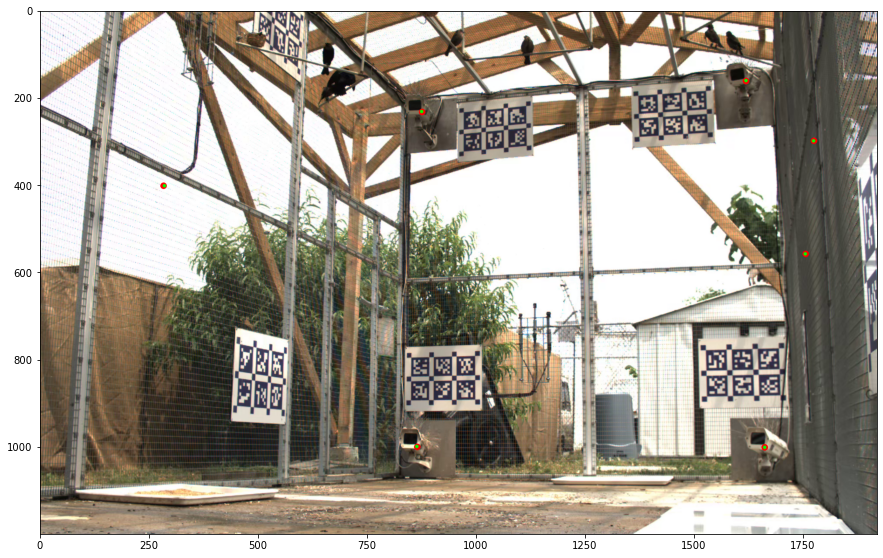

In [25]:
# plt is matplotlib.pyplot and can be used for displaying images (and also plotting)

# set the figure size to make it big
plt.figure(figsize=(15,20))
# plot the third image that is annotated with points
plt.imshow(imgs_with_reproj_points[5])
plt.show()

In [26]:
# If you use extrinsic_calib_v2.yaml:
# As you can see the matches aren't that great because the camera calibration is off

# If you use extrinsic_calib_v5.yaml:
# The reprojected points are almost right on top of their annotations

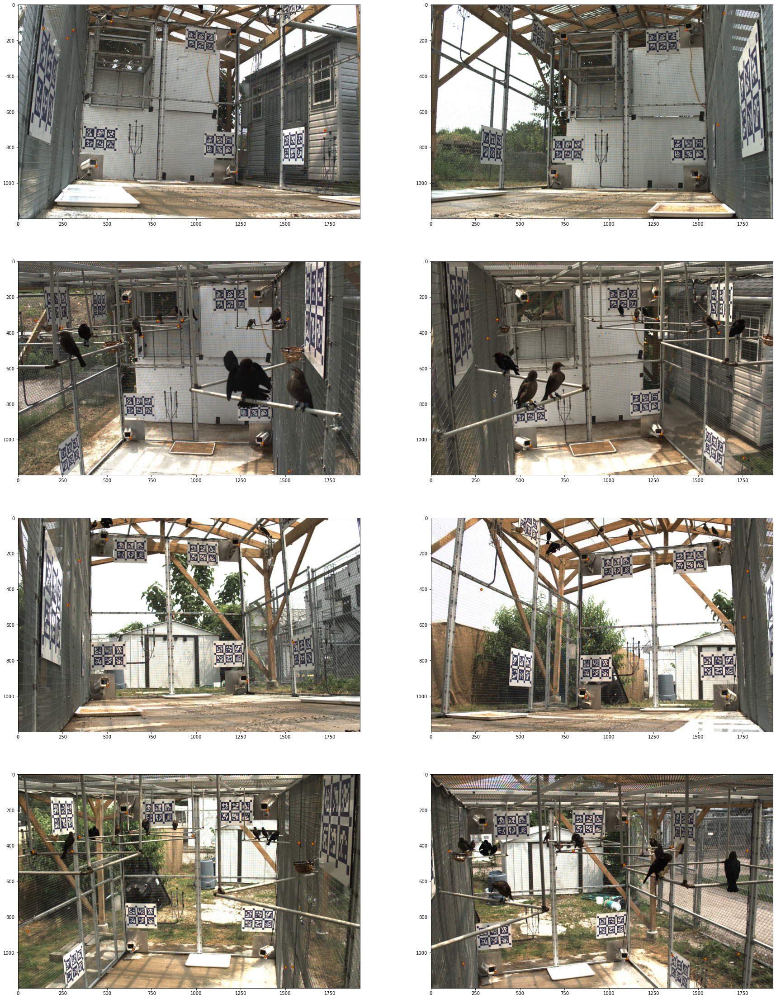

In [27]:
# We can plot all the views in a single figure

# set the figure size to make it big
fig, axs = plt.subplots(4, 2, figsize=(30,40))

for ax, img in zip(axs.reshape(-1), imgs_with_reproj_points):
    ax.imshow(img)

plt.show()

# # plot the third image that is annotated with points
# plt.imshow(imgs_with_reproj_points[3])
# plt.show()

# Allow the camera parameters to be adjusted as well as 3D point locations

In [8]:
# Now we define a loss for optimizing the camera parameters

def cam_fitting_loss(aviary_points, cam_rot_6d, camera_t, focal_length, camera_center,
                      keypoints_2d, keypoints_conf, sigma=50, distortion=None):

    device = aviary_points.device
    
    # Repeat the aviary points (num_pts,3) along the first dimension (num_cams,num_pts,3)
    # so they can project into each camera
    aviary_points = aviary_points[None,:]
    bs = cam_rot_6d.shape[0]
    aviary_points = aviary_points.repeat(bs,1,1).to(device)
    
    # convert 6D rotation parameterization back to rotation matrix to
    # use in perspective projection
    rotation = rot6d_to_rotmat(cam_rot_6d)
    
    projected_points = perspective_projection(aviary_points, rotation, camera_t,
                                                focal_length, camera_center, distortion)

    # Weighted robust reprojection loss
    reprojection_error = gmof(projected_points - keypoints_2d, sigma)
    reprojection_loss = (keypoints_conf ** 2) * reprojection_error.sum(dim=-1)

    print(reprojection_error)
    
    total_loss = reprojection_loss.sum(dim=-1)
    
    return total_loss.sum()

In [29]:
# set the initial values for the quantities we will be optimizing
frames = [cam_to_frame_map[cam] for cam in range(8)]
cam_rot, cam_t, focal_length, camera_center, distortion = mutils.get_cam(frames, device, 'extrinsic_calib_v5.yaml')

# optimizing entries of the rotation matrix is unstable, so we will optimize 6 parameters
# of a 6D rotation representation
#     Based on Zhou et al., "On the Continuity of Rotation Representations in Neural Networks", CVPR 2019
cam_rot_6d = cam_rot[:,:,0:2].reshape(-1,6)

valid_3d = aviary_points_3d[:, -1]>0
valid_apts_3d = aviary_points_3d[valid_3d, :3]

step_size=1e-6
num_iters=20000
batch_size = valid_apts_3d.shape[0]
gt_aviary_points = torch.from_numpy(aviary_points).to(device)
gt_2d = gt_aviary_points[:,:,:2]
gt_conf = gt_aviary_points[:,:,-1]

opt_points = valid_apts_3d.to(device)

cam_rot_6d.requires_grad = True
cam_t.requires_grad = True
focal_length.requires_grad = True
camera_center.requires_grad = True
distortion.requires_grad = True

opt_params = [{'params':opt_points, 'lr': 1e-4},
              {'params':cam_rot_6d, 'lr': 1e-5},
              {'params':cam_t, 'lr': 1e-5},
              {'params':focal_length},
              {'params':camera_center},
              {'params':distortion}]
cam_optimizer = torch.optim.Adam(opt_params, lr = step_size, betas=(0.9, 0.999))
last_loss = 0

pbar = tqdm(range(num_iters))
for i in pbar:

    loss = cam_fitting_loss(opt_points, cam_rot_6d, cam_t, focal_length, camera_center,
                            gt_2d, gt_conf, sigma=100, distortion=distortion)
    
    # if i % 100 == 0: print(loss)
    
    pbar.set_postfix({'loss': "{:.2f}".format(loss.detach().cpu())})
    
    if torch.isnan(loss):
        print(loss)
        print("loss diverged! Last loss: {}".format(last_loss))
        break
    
    else:
        last_loss = loss

    cam_optimizer.zero_grad()
    loss.backward()
    cam_optimizer.step()

# Output
opt_aviary_points = valid_apts_3d.detach().cpu()
opt_cam_rot = rot6d_to_rotmat(cam_rot_6d.detach())
opt_cam_t = cam_t.detach()
opt_cam_focal = focal_length.detach()
opt_cam_center = camera_center.detach()
opt_cam_distortion = distortion.detach()

  0%|          | 0/20000 [00:00<?, ?it/s, loss=nan]

tensor([[[1.0000e+04, 1.0000e+04],
         [1.0000e+04, 1.0000e+04],
         [1.0976e-01, 4.2239e-01],
         [1.5824e-02, 5.1608e-03],
         [6.6802e+03, 9.9374e+03],
         [1.0000e+04, 1.0000e+04],
         [6.0670e-01, 8.6870e-02],
         [1.1603e-01, 1.5192e-01],
         [9.8891e+03, 9.5572e+03],
         [9.9571e+03, 9.2323e+03],
         [9.9325e+03, 4.9490e+03],
         [9.9712e+03, 8.0960e+03],
         [9.9570e+03, 9.5560e+03],
         [1.6055e-02, 1.0212e+00],
         [9.9775e+03, 8.5119e+03],
         [9.4085e+03, 8.7235e+03],
         [9.3786e+03, 9.6579e+03],
         [2.3669e-01, 2.0859e+00],
         [6.4158e-02, 1.3726e-03],
         [3.9883e-02, 3.9114e-01],
         [9.9179e+03, 6.0190e+03]],

        [[1.0000e+04, 1.0000e+04],
         [1.0000e+04, 1.0000e+04],
         [2.9613e-01, 2.2104e-01],
         [3.9397e-01, 1.2506e-01],
         [1.0000e+04, 1.0000e+04],
         [1.0000e+04, 1.0000e+04],
         [3.7293e-02, 2.6756e-02],
         [9.8880e-

In [ ]:
# The optimization sometimes fails, so we may need to adjust the learning rates.

In [30]:
loss

tensor(nan, device='cuda:0', grad_fn=<SumBackward0>)

In [33]:
print(opt_cam_t)

tensor([[ 2.1757,  0.3374,  0.1927],
        [ 0.1052,  0.1690, -0.4535],
        [ 0.1752,  2.3155,  0.0373],
        [ 2.2093,  2.2044,  0.5475],
        [-1.3660,  1.0264,  5.3870],
        [-0.3573,  1.2755,  5.8586],
        [-1.0029,  1.1534,  6.2709],
        [-1.8503,  1.4227,  5.6267]], device='cuda:0')


In [34]:
cam_rot, cam_t, focal_length, camera_center, distortion = mutils.get_cam(frames, device)

In [35]:
# make a copy of the original aviary_points because it is the right shape for putting our results into
projected_points = aviary_points.copy()

# now reproject each 3D point onto all cameras
for pt_num, apt in enumerate(opt_aviary_points):
    X = apt[:3][None,None,:]
    n = opt_cam_rot.shape[0]
    proj_pt = perspective_projection(X.repeat(n,1,1).to(device), 
                                    opt_cam_rot, opt_cam_t, opt_cam_focal, 
                                    opt_cam_center, opt_cam_distortion).cpu().numpy()
    projected_points[:,pt_num,:2] = proj_pt.squeeze()

In [36]:
# Now we draw the reprojected points on the image:

imgs_with_opt_points = [img_utils.draw_kpts(ci, ap, r=1, color=(0,0,255)) 
                           for ci, ap in zip(imgs_with_reproj_points, projected_points)]

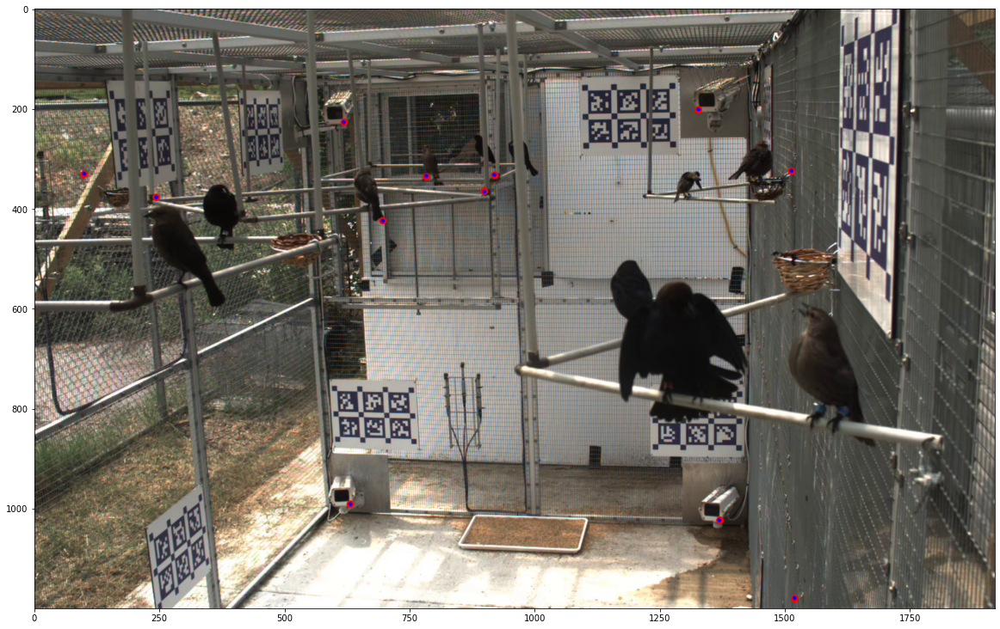

In [37]:
# plt is matplotlib.pyplot and can be used for displaying images (and also plotting)

# set the figure size to make it big
plt.figure(figsize=(20,30))
# plot the third image that is annotated with points
plt.imshow(imgs_with_opt_points[2])
plt.show()

# Save the updated calibration

In [38]:
# load a template calibration
calibs = yaml.safe_load(open(os.path.join(root, 'utils','extrinsic_calib_v3.yaml')))

In [39]:
new_calibs = calibs.copy()

In [40]:
opt_cam_rot[0].cpu().numpy().tolist()

[[-0.2556352913379669, -0.9655335545539856, 0.04894454777240753],
 [0.12618830800056458, -0.0835176631808281, -0.9884843826293945],
 [0.9585025310516357, -0.24651527404785156, 0.14318910241127014]]

In [41]:
new_calibs['cam0']['T_cam_imu']

[[-0.24615833163261414,
  -0.9679361581802368,
  0.05005452409386635,
  2.133859634399414],
 [0.1320890337228775,
  -0.08466409891843796,
  -0.9876154065132141,
  0.3180278241634369],
 [0.9601866602897644,
  -0.2364981472492218,
  0.14869453012943268,
  0.27930986881256104],
 [0.0, 0.0, 0.0, 1.0]]

In [42]:
new_calibs['cam0']['distortion_coeffs']

[0.23183664679527283,
 -1.1891916990280151,
 0.0013039320474490523,
 0.005049044732004404,
 -0.025799430906772614]

In [43]:
for cam_num, key in enumerate(sorted(new_calibs)):
    temp_P = np.eye(4)
    temp_P[:3, :3] = opt_cam_rot[cam_num].cpu().numpy()
    temp_P[:3, 3] = opt_cam_t[cam_num].cpu().numpy()
    new_calibs[key]['T_cam_imu'] = temp_P.tolist()
    
    temp_intrinsics = np.array(new_calibs[key]['intrinsics'])
    temp_intrinsics[:2] = np.repeat(opt_cam_focal[cam_num].cpu().numpy(),2)
    temp_intrinsics[2:] = opt_cam_center[cam_num].cpu().numpy()
    new_calibs[key]['intrinsics'] = temp_intrinsics.tolist()
    
    temp_distortion = opt_cam_distortion[cam_num].cpu().numpy()
    new_calibs[key]['distortion_coeffs'] = temp_distortion.tolist()

In [54]:
with open(os.path.join(root, 'utils','extrinsic_calib_vNEW.yaml'), 'w') as file:
    documents = yaml.dump(new_calibs, file)

# But cameras move slightly over time ...

In [ ]:
# NEXT: Cameras move over the course of the season, so we want to try to either
# 1. detect the april tags in the images
# 2. re-locate annotated points in new images using template matching
# to see if they provide enough points for good automated camera calibration.
#
# A python april tag detector to try:
# https://www.pyimagesearch.com/2020/11/02/apriltag-with-python/
# These are examples of the calibration boards in the aviary: view?_00017.png

# If you just want to play around with it, there is also an iphone app for your phone
# This will probably do a pretty good job of detecting tags on your computer screen
# https://apps.apple.com/us/app/apriltag/id736108128

## Detecting apriltags

In [51]:
def draw_tags(img, detections):
    image = img.copy()
    for r in detections:
        # extract the bounding box (x, y)-coordinates for the AprilTag
        # and convert each of the (x, y)-coordinate pairs to integers
        (ptA, ptB, ptC, ptD) = r.corners
        ptB = (int(ptB[0]), int(ptB[1]))
        ptC = (int(ptC[0]), int(ptC[1]))
        ptD = (int(ptD[0]), int(ptD[1]))
        ptA = (int(ptA[0]), int(ptA[1]))
        # draw the bounding box of the AprilTag detection
        cv2.line(image, ptA, ptB, (0, 255, 0), 2)
        cv2.line(image, ptB, ptC, (0, 255, 0), 2)
        cv2.line(image, ptC, ptD, (0, 255, 0), 2)
        cv2.line(image, ptD, ptA, (0, 255, 0), 2)
        # draw the center (x, y)-coordinates of the AprilTag
        (cX, cY) = (int(r.center[0]), int(r.center[1]))
        cv2.circle(image, (cX, cY), 5, (0, 0, 255), -1)
        # draw the tag family on the image
        #tagFamily = r.tag_family.decode("utf-8")
        tag_ID = str(r.tag_id)
        cv2.putText(image, tag_ID, (ptA[0], ptA[1] - 15),
            cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
    
    return image

In [52]:
# Set view_examples to True or False to view cropped examples and practice tags (example_*.png)
# or two sets of images from different months in the aviary (155*_view*)
view_examples = False

if view_examples:
    example_tag_files = glob(os.path.join(root,"examples_multiview","example_*.png"))
else:
    example_tag_files = glob(os.path.join(root,"examples_multiview","155*_view*"))
    
example_tag_files.sort()
example_tags = [cv2.cvtColor(cv2.imread(file),cv2.COLOR_BGR2RGB) for file in example_tag_files]
example_tags_gray = [cv2.cvtColor(tag,cv2.COLOR_RGB2GRAY) for tag in example_tags]

In [53]:
# Change these to optimize tag detection
quad_blur_param=1.0
quad_decimate_param=1.0

options = apriltag.DetectorOptions(families="tag36h11", border=1, 
                                   quad_decimate=quad_decimate_param, quad_blur=quad_blur_param,
                                   refine_decode=True, refine_pose=True, quad_contours=True)
detector = apriltag.Detector(options)

results = [detector.detect(img) for img in example_tags_gray]

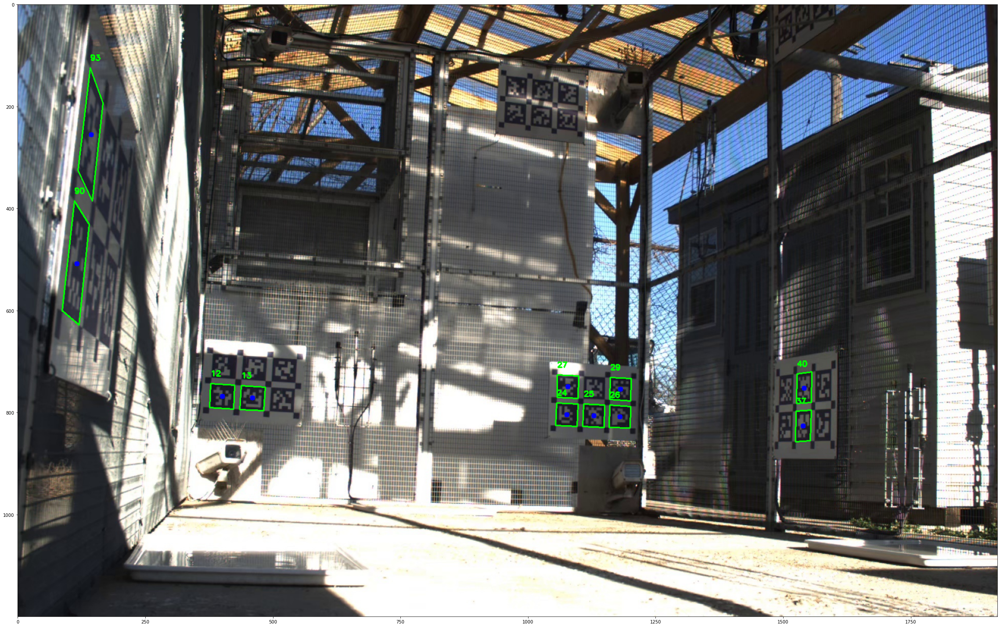

[12, 13, 24, 25, 26, 27, 29, 37, 40, 90, 93] 



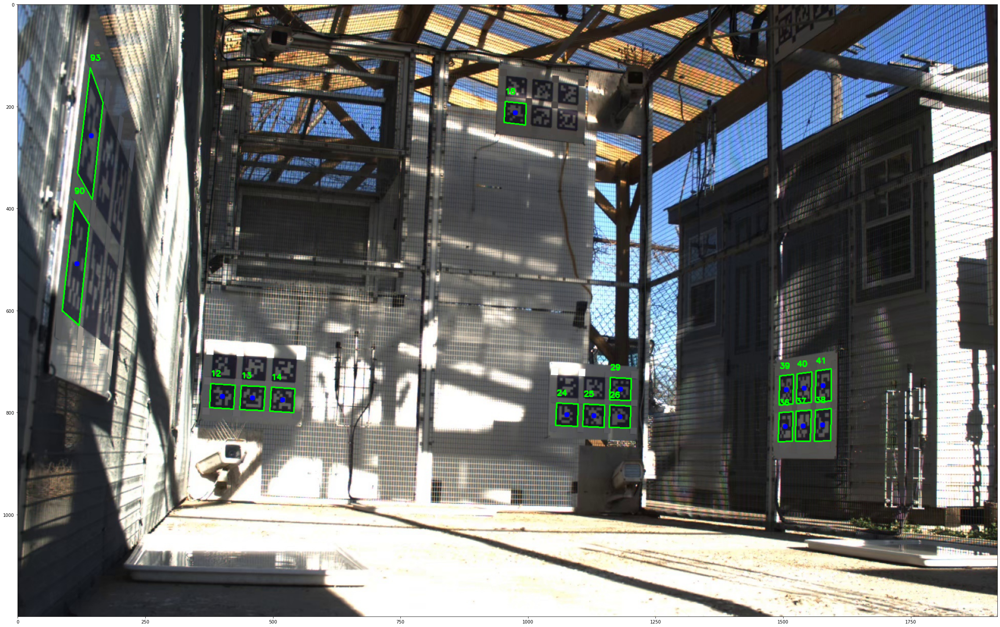

[12, 13, 14, 18, 24, 25, 26, 29, 36, 37, 38, 39, 40, 41, 90, 93] 



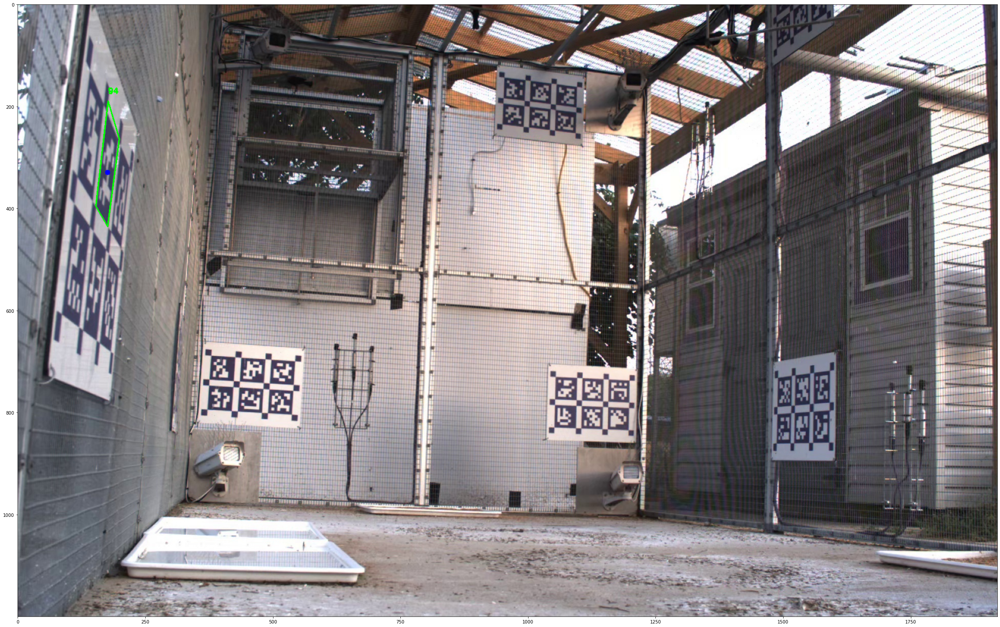

[94] 



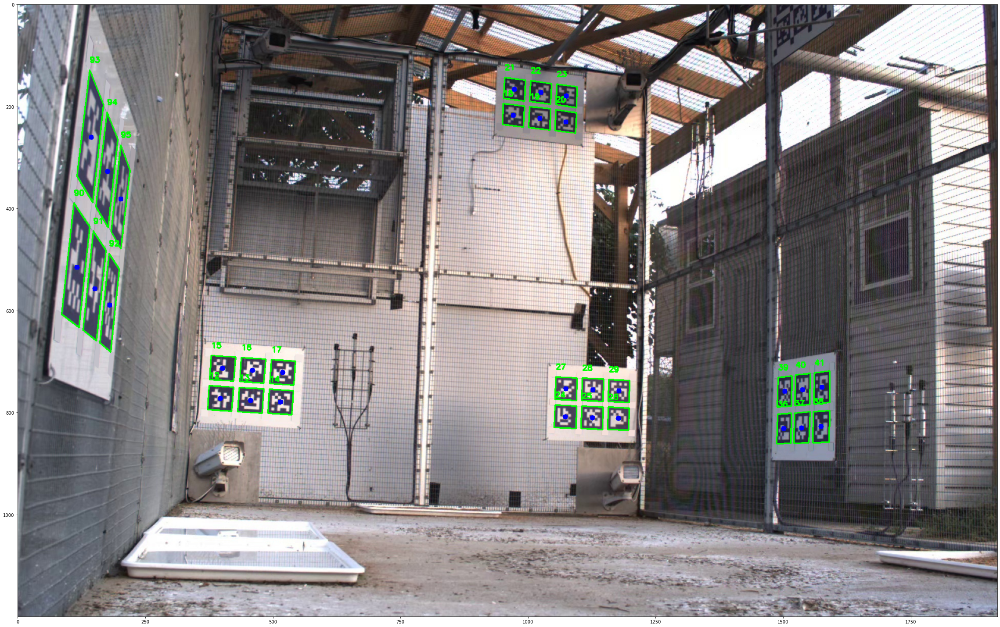

[12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 36, 37, 38, 39, 40, 41, 90, 91, 92, 93, 94, 95] 



In [54]:
if view_examples:
    display_tags = example_tags
    display_results = results
else:
    idxs_to_display = [0,1,9,10]
    display_tags = [x for i, x in enumerate(example_tags) if i in idxs_to_display]
    display_results = [x for i, x in enumerate(results) if i in idxs_to_display]
for tag, result in zip(display_tags, display_results):
    image = draw_tags(tag, result)
    # show the output image after AprilTag detection
    plt.figure(figsize=(40,50))
    plt.imshow(image)
    plt.show()
    print([det.tag_id for det in result], '\n')

In [315]:
# As you can see, the apriltag detector is getting messed up by the dark squares at the tag corners...
# We will either need to:
# 0. play with the detector settings more to see if we can get it working (try this first)
# 1. find a good way to automatically remove the dark squares at the corners (hard)
# 2. modify or use a different tag detector (probably hard)
# 3. use a template image to search for hand clicked aviary points

# Adjusting the detector settings

In [ ]:
# Do some stuff here...

# Finding annotated points in new images

In [ ]:
# We can try to compute convolutions of a template crop from the annotated image
# with the new unannotated image from the same view to find the location in the unannotated image.

# e.g. https://scikit-image.org/docs/0.12.x/auto_examples/transform/plot_register_translation.html
# Note skimage.feature.register_translation has been replaced by skimage.registration.phase_cross_correlation
# https://scikit-image.org/docs/stable/api/skimage.registration.html#skimage.registration.phase_cross_correlation